In [3]:
%load_ext autoreload
%autoreload 2

# add the parent directory in the path to import the packages
import sys
sys.path.append('../')

import plotly.express as px
from WaterClassification.core import *
from WaterClassification.Radiometry import RadiometryDB, Radiometry
from WaterClassification.Fitting import *
from pathlib import Path

from functools import partial



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Data Normalization
To compare different water classes, it is important to consider not only magnitude of the reflectance values, but also the shape of the reflectance curve. <br>
We already know that the higher the SPM concentration, the higher will be the reflectances. <br>
If we perform the clustering by taking into account just the absolute reflectance, it will prone to separate the cluster according to the overall mean reflectance (brightness) and it will pay little attention to the intrinsic characteristics of the reflectance.<br>
In this case, as proposed by Vantrepotte (2012), we can perform a normalization, dividing the reflectances by the curve area, so we can keep all the reflectances curves with the same area (brightness).<br><br>
This effect will be represented bellow:

In [4]:
db = RadiometryDB(r'D:\OneDrive - Agência Nacional de Águas\Data\GET-RadiometryDB')

db.load_radiometries(r_types=['Rrs', 'Rrs_OSOAA'], 
                     norm=True,                                                       # create the normalized bands and also the area
                     funcs=partial(calc_area, col_name='flatness', norm_band='700'),  # create the flatness band
                     qry="SPM > 0 and Status != 'Deleted'"                            # clear deleted and no data
                    )

rrs = db.rdmtries['Rrs']

Radiometries ['Rrs', 'Rrs_OSOAA'] loaded in dictionary .rdmtries


## Example (Madeira)
These are the reflectances from Madeira river. We can note that even though the absolute values can vary greatly, the general aspect (shape) of the curves remains almost the same.

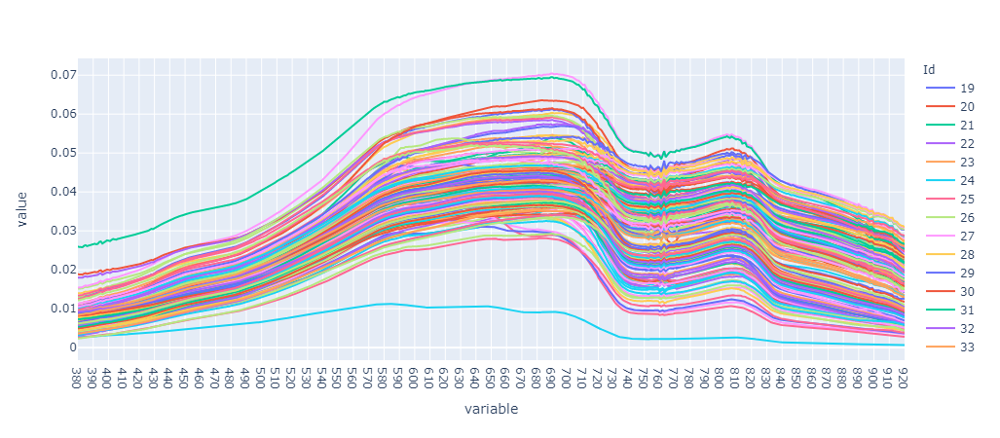

In [5]:
subdf = rrs.query("Area == 'Madeira'")
plot_reflectances(subdf, bands=all_wls)

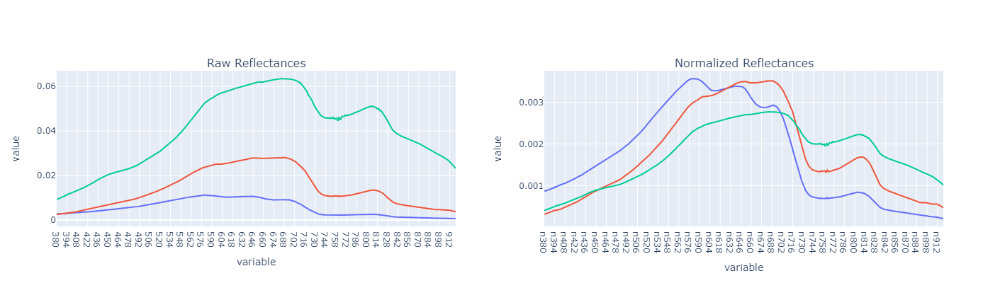

In [6]:
plot_figures(1, 2, [plot_ids(subdf, ids=[457, 839, 698], bands=all_wls),
                    plot_ids(subdf, ids=[457, 839, 698], bands=all_wls_norm)], titles=['Raw Reflectances', 'Normalized Reflectances'])

## Sensibility to low reflectances
The lower the overall reflectances, the "noisier" will become the normalized reflectances. This effect can be seen on the right end of the red curve above.<br>
Additionally, we can see in Negro (samples bellow) that the normalized curves will greatly change according to minimal increases in the reflectance:

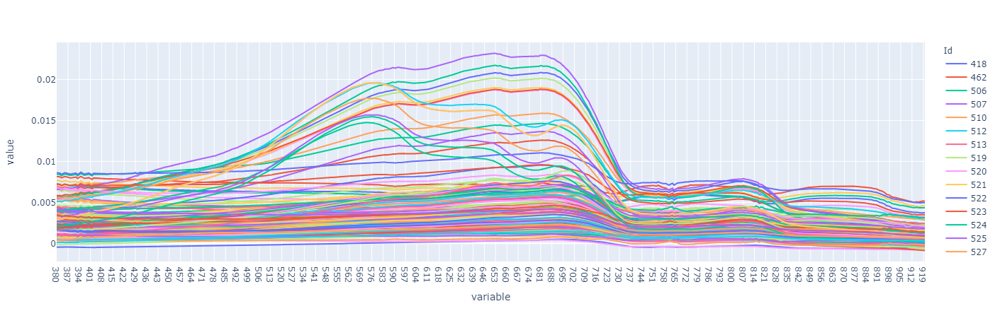

In [7]:
subdf = rrs.query("Area == 'Negro'")
plot_reflectances(subdf, bands=all_wls)

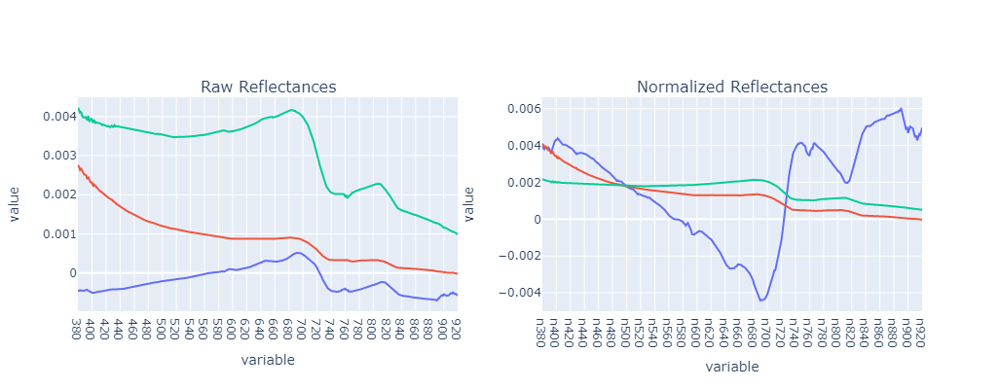

In [8]:
ids = [418, 521, 703]
plot_figures(1, 2, [plot_ids(subdf, ids=ids, bands=all_wls),
                    plot_ids(subdf, ids=ids, bands=all_wls_norm)], titles=['Raw Reflectances', 'Normalized Reflectances'])

We can note that the blue curve that is around 0 (very small area) has a completly "wrong" normalized reflectance. This will interfere with the clustering procedure and should be cleaned beforehand.<br>
As an example, we can see bellow the results of a clustering using normalized bands without the cleaning. Many groups repeat, because during the split the outlier is splitted and it remains alone in a cluster. And there is a threshold when the clusters have fewer than 10 samples... :(

In [10]:
# dic = load_obj('data/norm2_clusters_by_K_1nm.dic')
# dic

# Data Cleaning
## Outliers Detection
As we want to work with the normalized reflectances. It is important to "clean" the data for those outliers. <br>
We will apply a simple procedure to look for outliers at some "key" reflectances by using the Sentinel 2 bands. 

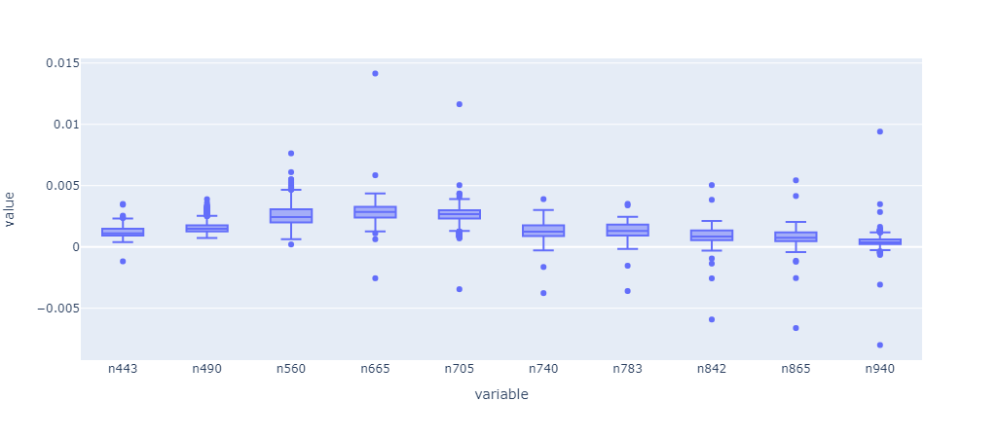

In [11]:
px.box(rrs, y=s2bands_norm, hover_data=[rrs.index])

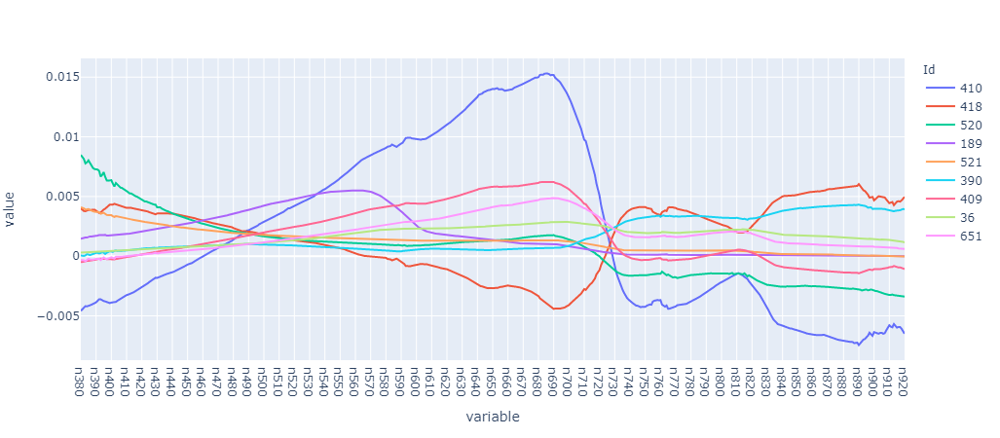

In [12]:
suspected = [410, 418, 520, 189, 521, 390, 409, 36, 651]
plot_ids(rrs, suspected, bands=all_wls_norm)

Another way to look at those outliers is by decomposing them into a lower dimension. The outliers will be really difficult to be represented in the lowered dimension and will be 

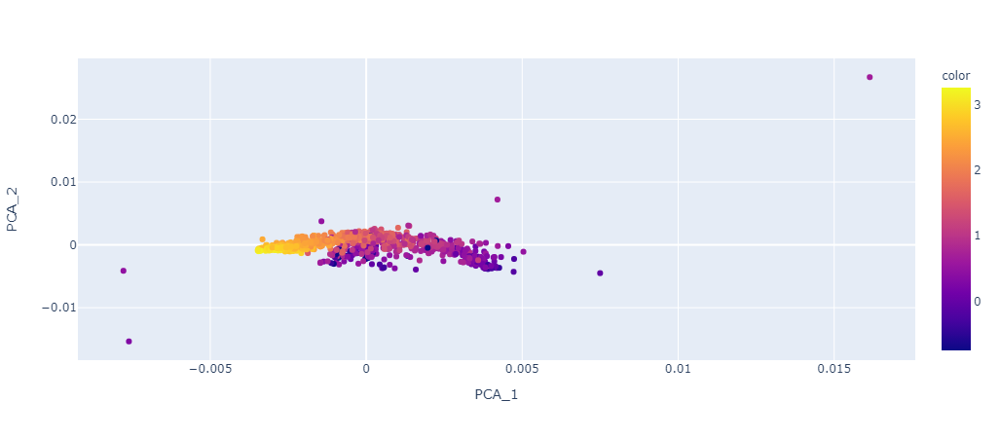

In [13]:
from sklearn import decomposition

# get the reflectances as a numpy array
xtrain = rrs[s3bands_norm].to_numpy()

# decompose them in n=2 components
pca = decomposition.PCA(n_components=2)
pca_modes = pca.fit_transform(xtrain)

# create a PCA dataframe
pca_df = pd.concat([rrs.reset_index()[['Id', 'SPM', 'Area', 'area']], pd.DataFrame(pca_modes, columns=['PCA_1', 'PCA_2'])], axis=1)

# Plot it
px.scatter(pca_df, x='PCA_1', y='PCA_2', color=np.log10(rrs['SPM']), hover_data=['Id', 'SPM', 'Area'])

In [14]:
[410, 418, 390, 520, 409]

[410, 418, 390, 520, 409]

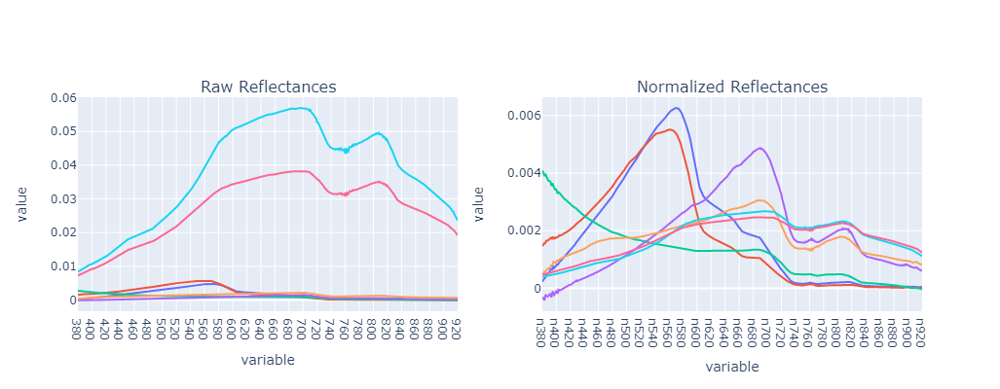

In [15]:
ids = [185, 189, 521, 651, 744, 697, 780]
plot_figures(1, 2, [plot_ids(rrs, ids=ids, bands=all_wls),
                    plot_ids(rrs, ids=ids, bands=all_wls_norm)], titles=['Raw Reflectances', 'Normalized Reflectances'])

In [16]:
rrs.query("Status == 'Suspicious'")

,Area_2,Station_2,Measurement,Start_Date_2,SPM_2,Status_2,Description_2,319,320,321,...,n943,n944,n945,n946,n947,n948,n949,n950,n951,flatness
Id,,,,,,,,,,,,,,,,,,,,,
380,Saut_Hermina,Crik,20151118-1051,2015-11-18 10:51:24,8.0,Suspicious,NaN,NaN,0.001802,0.001787,...,6.148152e-05,4.330515e-05,0.000025,0.000011,0.000002,-0.000007,-0.000026,-0.000019,NaN,-1.860558
381,Saut_Hermina,SH_1,20151118-1111,2015-11-18 11:11:53,7.0,Suspicious,NaN,NaN,0.004012,0.003914,...,2.743198e-04,2.660006e-04,0.000240,0.000238,0.000249,0.000241,0.000230,0.000215,NaN,-2.665590
382,Saut_Hermina,SH_2,20151118-1114,2015-11-18 11:14:57,9.0,Suspicious,NaN,NaN,0.004656,0.004498,...,2.710732e-04,2.504581e-04,0.000227,0.000226,0.000233,0.000238,0.000226,0.000208,NaN,-2.882741
383,Saut_Hermina,SH_3,20151118-1121,2015-11-18 11:21:49,6.0,Suspicious,NaN,NaN,0.003749,0.003717,...,-9.944998e-05,-1.005093e-04,-0.000102,-0.000090,-0.000065,-0.000039,-0.000036,-0.000077,NaN,-2.628394
384,Saut_Hermina,SH_4,20151118-1127,2015-11-18 11:27:29,6.0,Suspicious,NaN,NaN,0.004618,0.004527,...,1.277752e-04,1.325982e-04,0.000110,0.000097,0.000112,0.000126,0.000121,0.000103,NaN,-2.903744
385,Saut_Hermina,Crik,20151119-1048,2015-11-19 10:48:21,6.0,Suspicious,NaN,NaN,0.005158,0.005163,...,2.434519e-04,2.254982e-04,0.000212,0.000216,0.000217,0.000220,0.000223,0.000219,NaN,-1.277934
386,Saut_Hermina,SH_1,20151119-1103,2015-11-19 11:03:21,10.0,Suspicious,NaN,NaN,0.007322,0.007398,...,3.283401e-04,3.305287e-04,0.000288,0.000286,0.000307,0.000294,0.000279,0.000269,NaN,-4.077251
387,Saut_Hermina,SH_2,20151119-1107,2015-11-19 11:07:46,12.0,Suspicious,NaN,NaN,0.007137,0.007022,...,1.605723e-04,1.510663e-04,0.000148,0.000141,0.000133,0.000143,0.000138,0.000148,NaN,-5.011167
388,Saut_Hermina,SH_3,20151119-1112,2015-11-19 11:12:31,11.0,Suspicious,NaN,NaN,0.006954,0.006873,...,1.927094e-04,1.824887e-04,0.000162,0.000166,0.000168,0.000158,0.000151,0.000158,NaN,-4.428716


In [17]:
negative = rrs[(rrs[s2bands] < 0).any(axis=1)][s2bands]

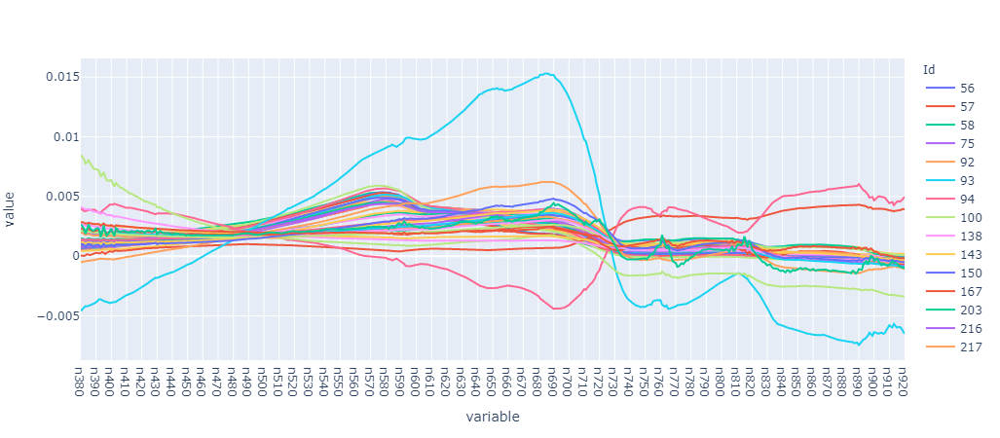

In [18]:
plot_ids(rrs, ids=negative.index, bands=all_wls_norm)